# **Projet Modélisation Numérique pour la physique**

## Ben Sadoun Théo et Haddad Sami

---

## **Introduction**

La dynamique d’une particule chargée dans un champ magnétique est un phénomène fondamental en physique, qu’on retrouve dans de nombreux contextes tels que la spectrométrie de masse ou la protonthérapie.

Dans ce projet, on adopte un point de vue pédagogique : l’objectif est de visualiser et comprendre comment un champ magnétique influence la trajectoire d’une particule chargée. L’approche se veut progressive : on commence par des cas simples avec un champ uniforme, puis on enrichit le modèle avec des champs plus réalistes.

Ce type de simulation permet d’illustrer concrètement la force de Lorentz et les notions de champ vectoriel, trajectoires dans l’espace, et méthodes numériques de résolution d’équations différentielles.

Nous verrons ainsi dans un premier temps comment déterminer mathématiquement la position d'une particule soumis à un champ magnétique à un instant t, à l'aide de la force de Lorentz. <br>
Puis nous modéliserons la trajectoire de celle-ci au sein d'un champ uniforme, et compareronsdifférentes méthodes d'intégrations numériques. <br>
Enfin, nous observerons les conséquences de la manipultion de champs magnétiques appliquée à la protonthérapie.

---

## **Problématique**

1. ***Comment un champ magnétique affecte-t-il la trajectoire d’une particule chargée en mouvement ?***

2. ***Comment simuler le mouvement d’une particule chargée soumise à un champ magnétique statique, et observer l’influence du champ sur sa trajectoire dans différents cas ?***

3. ***Comment l'influence d'un champ magnétique peut-il aider dans la protonthérapie ?***

---

### **I. Création de l'objet Particule**

Nous allons donc dans un premier temps implémenter l'objet particule, auquel on associe une position, une vitesse, une masse et une charge. On lui attribuera également une fonction permettant de calculer la force de Lorentz appliquée à cette particule à travers un champ magnétique, donnée par :
$$
\boxed{
\overrightarrow{F} = q \ \vec{v} \ ∧ \ \overrightarrow{B}
}
\tag{1}
$$

In [57]:
import numpy as np

class Particule:
    def __init__(self, position, vitesse, masse, charge):
        """
        Initialise une particule chargée.

        position : np.array shape (3,) -> position initiale (x, y, z)
        vitesse  : np.array shape (3,) -> vitesse initiale (vx, vy, vz)
        masse    : float -> masse de la particule (en kg)
        charge   : float -> charge électrique (en Coulombs)
        """
        self.position = np.array(position, dtype=float)
        self.vitesse = np.array(vitesse, dtype=float)
        self.masse = masse
        self.charge = charge

    def force_lorentz(self, champ_magnetique):
        """
        Calcule la force de Lorentz : F = q * (v ∧ B)

        champ_magnetique : np.array shape (3,) -> champ B au point de la particule
        """
        return self.charge * np.cross(self.vitesse, champ_magnetique)  # Produit vectoriel

---

### **II. Déterminer la position d'une particule à un instant t à l'aide de la Force de Lorentz**

Dans cette partie nous allons voir comment déterminer, à l'aide des lois de Lorentz et Newton, les équations du mouvement d'une particule de charge $q$ soumise à un champ magnétique $\overrightarrow{B}$. <br>
<br>
Nous avons vu précédemment que la force appliquée à une particule au sein d'un champ magnétiuque, et en l'abscence de champ électrique, nous est donnée par la force de Lorentz (1) :
$$
\overrightarrow{F} = q \ \vec{v} \ ∧ \ \overrightarrow{B}
$$

Or on sait d'après la seconde loi de Newton que :
$$
\sum {\overrightarrow{F}} = m \times \vec{a}
\tag{2}
$$

On considère que la seule force appliquée à notre particule est celle de Lorentz. En appliquant la seconde loi de Newton (2) à l'équation de Lorentz (1), on obtient :
$$
\begin{aligned}
m \times \vec{a} &= q \ \vec{v} \ ∧ \ \overrightarrow{B} \\
m \times \frac{\mathrm{d} \vec{v}} {\mathrm{d}t} &= q \ \vec{v} \ ∧ \ \overrightarrow{B} \\
\end{aligned}
$$

Cela donne un système d'équations différentielles pour les composantes de $\vec{v}$. <br>
Prenons par exemple le cas d'un champ magnétique uniforme : $\overrightarrow{B} = B \vec{e}_z$ <br>
On peut alors écrire les équations du mouvement associées. <br>
En coordonnées cartésiennes :
$$
\begin{cases} 
\dfrac{\mathrm{d}v_x}{\mathrm{d}t} = \dfrac{qB}{m} v_y \\
\dfrac{\mathrm{d}v_y}{\mathrm{d}t} = -\dfrac{qB}{m} v_x \\
\dfrac{\mathrm{d}v_z}{\mathrm{d}t} = 0
\end{cases}
$$

On peut poser : $\omega_c = \dfrac{qB}{m} = \text{fréquence cyclotron}$ (désignant la pulsation qu'acquiert une charge plongée dans un champ magnétique).

Résolvons les équations en intégrant. Les solutions sont alors :
$$
\begin{cases}
v_x(t) = v_0 \cos(\omega_c t) \\
v_y(t) = v_0 \sin(\omega_c t) \\
v_z(t) = v_{z0}
\end{cases}
$$

Puis, on intègre une seconde fois pour obtenir la trajectoire :

$$
\begin{cases}
x(t) = x_0 + \dfrac{v_0}{\omega_c} \sin(\omega_c t) \\
y(t) = y_0 - \dfrac{v_0}{\omega_c} \cos(\omega_c t) + \dfrac{v_0}{\omega_c} \\
z(t) = z_0 + v_{z0} t
\end{cases}
$$
<br>
Cette méthode d'intégration permettant de déterminer la trajectoire de l'une particule peut être calculée de manière numérique, ce que nous verrons dans la partie III.

---

### **III. Comparaison de méthodes d'intégrations numériques et étude de la trajectoire d'un électron dans différents types de champs**

L'objectif ici est de comparer différentes méthodes de résolution numériques afin de déterminer la trajectoire d'un électron, au sein de différents types de champs magnétiques.

<br>

#### **III.1. Cas 1 : Simulation de la trajectoire d'un électron au sein d'un champ uniforme**

Nous allons maintenant tracé la trajectoire d'un électron au sein d'un champ uniforme. <br>
Pour cela, on commence par définir un champ uniforme en z, ainsi que les attributs de l'électron (position initale, vitesse, masse et charge) :

In [58]:
# Définir un champ magnétique uniforme B = (0, 0, 1) T
def champ_uniforme(position=None):
    return [0, 0, 1]        # T (Tesla)

# Créer une particule : électron
electron = Particule(
    position = [0, 0, 0],   # m
    vitesse = [1e6, 0, 0],  # m/s
    masse = 9.11e-31,       # kg
    charge = -1.6e-19       # C
)

##### **III.1.1 Simulation via la méthode d'Euler explicite**

On travaille dans un premier temps avec la méthode d'Euler pour l'évolution de la position de la particule dans le temps. Elle est connue pour sa simplicité, et consiste à approximer la solution d'une équation différentielle en utilisant la pente locale à chaque pas de temps. <br>
Pour une particule chargée :
$$
\begin{align*}
\frac{d\vec{v}}{dt} &= \frac{q}{m}\left(\vec{E} + \vec{v} ∧ \vec{B}\right) \\
\vec{v}_{n+1} &= \vec{v}_n + \Delta t \cdot \frac{q}{m}\left(\vec{E}_n + \vec{v}_n ∧ \vec{B}_n\right) \\
\vec{x}_{n+1} &= \vec{x}_n + \Delta t \cdot \vec{v}_n
\end{align*}
$$

<br>
On définit alors les paramètres de la simulation, puis la fonction de simulation que l'on execute pour un temps défini, afin de déterminer la position de la particule à chaque instant à l'aide de la force de Lorentz qui lui est appliquée dans ce champ uniforme. Ce qui nous permettra de tracer par la suite, la trajectoire de la particule dans l'espace. <br>
<br>
Ici, le choix des paramètres de temps de la simulation est essentiel. En effet, il est important de constater que la force de Lorentz magnétique ne travaille pas, et ne modifie donc pas l’énergie cinétique des particules. Elle dévie une charge sans changé son énergie. On peut donc comparer la simulation pour différentes valeurs de dt, afin d'observer laquelle est pertinente, c'est à dire laquelle correspond à une invariance de l'énergie de la particule.

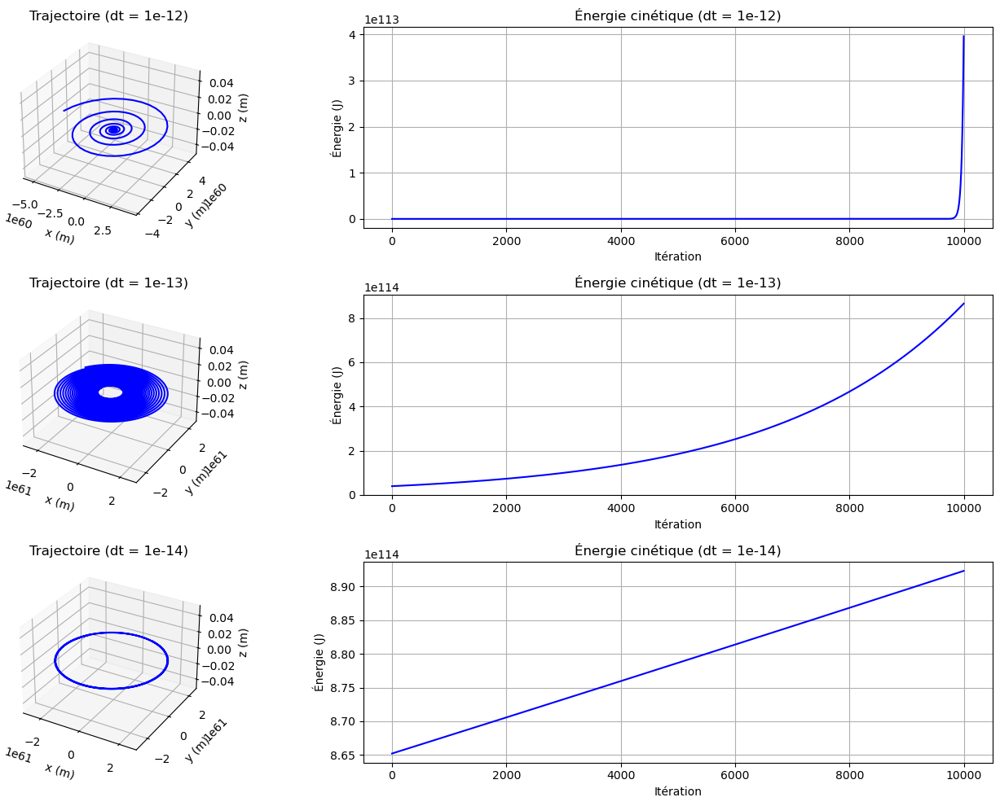

In [59]:
import matplotlib.pyplot as plt

# Simulation pour un dt donné
def simuler_trajectoire_euler(B, dt, steps):
    positions = []  # pour stocker les positions de la particule au cours de la simulation
    energies = []   # pour stocker l'évolution de l'énergie de la particule au cours de la simulation

    # Boucle de simulation (Méthode d'Euler)
    for _ in range(steps):
        B_vect = B(electron.position) if callable(B) else B
        F = electron.force_lorentz(B_vect)          # Force de Lorentz
        a = F / electron.masse                      # Accélération
        electron.vitesse += a * dt                  # Mettre à jour la vitesse
        electron.position += electron.vitesse * dt  # Mettre à jour la position
        positions.append(electron.position.copy())  # Stocker la position actuelle
        Ec = 0.5 * electron.masse * np.linalg.norm(electron.vitesse) ** 2  # Énergie cinétique
        energies.append(Ec)                         # Stocker les valeurs de l'énergie cinétique

    return np.array(positions), np.array(energies)

# ==================== Simulation avec la méthode d'Euler ==================== #

# Paramètres de test
dts = [1e-12, 1e-13, 1e-14]
steps = 10000

trajectoires = []  # Pour stocker les différentes trajectoires en fonction de dt
energies = []      # Pour stocker les différentes énergies cinétiques  en fonction de dt

# Exécution des simulations pour les différentes valeurs de dt
for dt in dts:
    pos, E = simuler_trajectoire_euler(champ_uniforme(), dt, steps)  # Appliquer la simulation
    trajectoires.append(pos)                       # Enregistrer la trajectoire obtenue
    energies.append(E)                             # Enregistrer l'énergie cinétique obtenue

# Tracé des trajectoires en 3D pour chaque trajectoire/énergie enregistrée
fig = plt.figure(figsize=(15, 10))

for i, dt in enumerate(dts):
    ax = fig.add_subplot(3, 2, 2*i+1, projection='3d')
    ax.plot(trajectoires[i][:, 0], trajectoires[i][:, 1], trajectoires[i][:, 2], color="blue")
    ax.set_title(f"Trajectoire (dt = {dt:.0e})")
    ax.set_xlabel("x (m)")
    ax.set_ylabel("y (m)")
    ax.set_zlabel("z (m)")

    ax2 = fig.add_subplot(3, 2, 2*i+2)
    ax2.plot(energies[i], color="blue")
    ax2.set_title(f"Énergie cinétique (dt = {dt:.0e})")
    ax2.set_xlabel("Itération")
    ax2.set_ylabel("Énergie (J)")
    ax2.grid()

plt.tight_layout()
plt.show()


On observe alors que dans les cas où $\mathrm{d}t = 10^{-12}$ s et $\mathrm{d}t = 10^{-13}$ s, l'évolution de l'énergie cinétique n'est pas linéaire, contrairement au cas où $\mathrm{d}t = 10^{-14}$ s où la courbe représentant l'évolution de l'énergie cinétique au cours du temps est une droite passant par l'origine. Dans ce cas, la trajectoire est correcte.<br>
Or, dans tous les cas, on observe une augmentation de l'énergie cinétique, le principe de conservation énergétique n'est donc pas respecté avec la méthode d'Euler. Nous verrons par la suite qu'il existe une méthode qui permet de respecter ce principe. <br>
<br>
Analysons pour le moment le cas où $\mathrm{d}t = 10^{-14}$ s qui semble montrer une trajectoire cohérente :

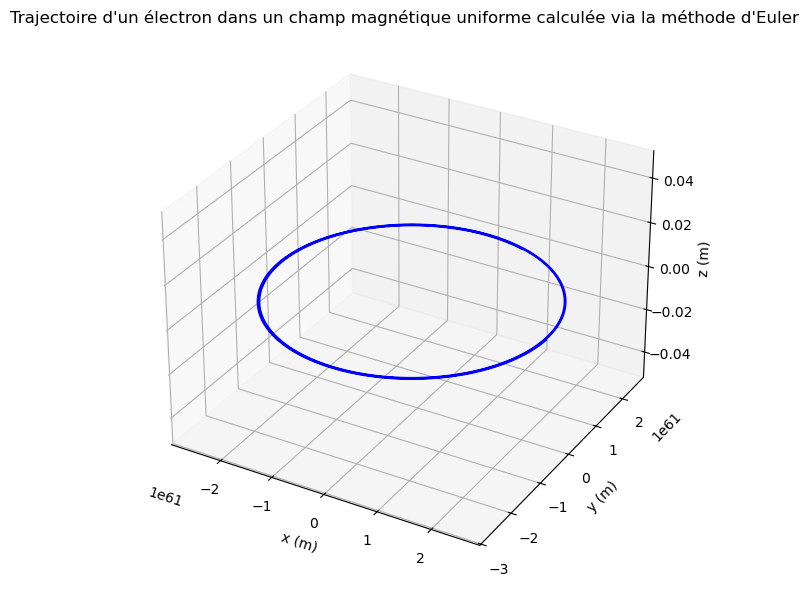

In [60]:
# Paramètres de la simulation
dt = 1e-14      # intervalle de temps (s)
time = 10000    # nombre d'itérations

positions = []  # pour stocker les positions de la particule au cours de la simulation

# Simuler la trajectoire de l'électron
positions, _ = simuler_trajectoire_euler(champ_uniforme(), dt, time)  # Exécuter la simulation

# Tracé de la trajectoire en 3D
fig = plt.figure(figsize=(9, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot(positions[:, 0], positions[:, 1], positions[:, 2], color="blue")
ax.set_title("Trajectoire d'un électron dans un champ magnétique uniforme calculée via la méthode d'Euler")
ax.set_xlabel('x (m)')
ax.set_ylabel('y (m)')
ax.set_zlabel('z (m)')
plt.tight_layout()
plt.show()

On observe alors que la trajectoire est un cercle parfait, ce qui est cohérent avec la formule de Lorentz (1), puisque on est dans le cas où $\overrightarrow{B} ⊥ \vec{v}$, donc la force $\overrightarrow{F}$ est maximale et provoque un mouvement circulaire. <br>
En effet dans notre cas, le produit vectoriel $\vec{v} \times \vec{B}$ donne :
$$
\vec{F} = q \begin{pmatrix}
v_x \\
v_y \\
v_z
\end{pmatrix} \times \begin{pmatrix}
0 \\
0 \\
B_z
\end{pmatrix} = q \begin{pmatrix}
v_y B_z - v_z \cdot 0 \\
-v_x B_z + 0 \\
0
\end{pmatrix} = q \begin{pmatrix}
0 \\
-v_x B_z \\
0
\end{pmatrix}
$$

La particule est alors déviée vers le négatif de l'axe y, et à tout instant la force reste perpendiculaire à la vitesse. Ce genre de force centripète fait que la particule tourne en rond. <br>
<br>

Mais bien que la méthode d'Euler soit simple à implémenter, et fonctionne avec un calcul rapide par itération directe, elle possède également des inconvénients, comme :
- Peu précis pour de longues simulations
- Ne conserve pas l’énergie : la particule peut "accélérer" indéfiniment dans un champ magnétique seul, ce qui est physiquement incorrect
- Mauvaise stabilité numérique si le champ est fort ou si le pas de temps est trop grand

<br>

**Modélisation :**

- Configuration de la figure :

Pour modéliser en temps réel, on commence par créer une figure 3D avec des axes étiquetés, une ligne pour la traînée, et un point pour l’électron. Les limites des axes sont ajustées pour afficher clairement le cercle dans le plan \( xy \).

(-1e-06, 1e-06)

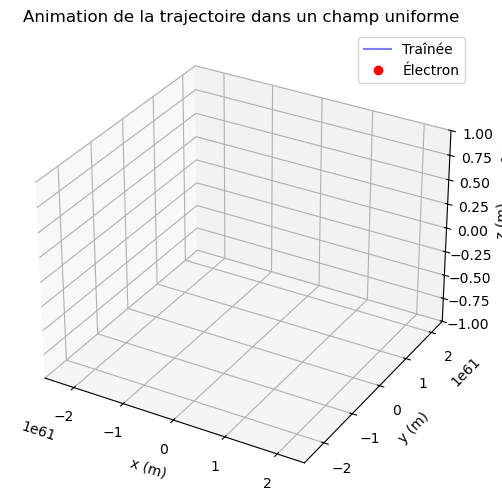

In [61]:
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlabel('x (m)')
ax.set_ylabel('y (m)')
ax.set_zlabel('z (m)')
ax.set_title('Animation de la trajectoire dans un champ uniforme')

line, = ax.plot([], [], [], 'b-', alpha=0.5, label='Traînée')
point, = ax.plot([], [], [], 'ro', label='Électron')
ax.legend()

ax.set_xlim(min(positions[:, 0]), max(positions[:, 0]))
ax.set_ylim(min(positions[:, 1]), max(positions[:, 1]))
ax.set_zlim(-1e-6, 1e-6)  # z constant

- Définition des fonctions d’animation :

On définit ensuite une fonction pour initialiser l’animation (vide au départ) et une autre pour mettre à jour chaque frame, en affichant une traînée de 20 points et la position actuelle de l’électron. Le sous-échantillonnage réduit la taille de l’animation.

In [62]:
def init():
    line.set_data([], [])
    line.set_3d_properties([])
    point.set_data([], [])
    point.set_3d_properties([])
    return line, point

def update(frame):
    start = max(0, frame*18 - 20)
    line.set_data(positions[start:frame*18+1:18, 0], positions[start:frame*18+1:18, 1])
    line.set_3d_properties(positions[start:frame*18+1:18, 2])
    point.set_data([positions[frame*18, 0]], [positions[frame*18, 1]])
    point.set_3d_properties([positions[frame*18, 2]])
    return line, point

- Rendu de l’animation

On génère l’animation avec 200 frames (sous-échantillonnées tous les 18 pas) et un intervalle de 10 ms pour une vidéo de 2 secondes. Le rendu HTML produit une vidéo interactive avec des contrôles play/pause.

In [63]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

ani = FuncAnimation(fig, update, frames=steps//18, init_func=init, interval=10, blit=True)
HTML(ani.to_jshtml())

Animation size has reached 20988141 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<br>

##### **III.1.2. Simulation via la méthode de Boris**

On a vu dans la partie précédente les limites de la méthode d'Euler pour la simulation physique d'un électron se déplaçant à une vitesse $\vec{v}$ au sein d'un champ magnétique, à savoir la nécessité d'ajuster les paramètres temporels (avec un dt très petit) afin d'obtenir une trajectoire correcte.<br>
Il est donc préférable d'opter pour une méthode de résolution numérique plus adaptée. En l'occurence, penchons nous sur la méthode de Boris qui est très adaptée à notre cas (voir [Annexe](#Annexe)). <br>
La méthode de Boris est une méthode semi-implicite conçue spécialement pour les équations du mouvement de particules chargées dans un champ magnétique. Elle sépare le traitement du champ électrique et du champ magnétique, et conserve l’énergie dans le cas d’un champ magnétique pur (sans champ électrique). <br>
<br>
On souhaite résoudre l'équation du mouvement :

$$
\frac{d\vec{v}}{dt} = \frac{q}{m} \left( \vec{v} \times \vec{B} \right)
$$

La méthode de Boris découpe chaque itération en trois étapes :
1. Demi-accélération par le champ électrique
$$
\vec{v}^- = \vec{v}_n + \frac{q\vec{E}}{2m}\Delta t
$$
2. Rotation dans le champ magnétique
$$
\begin{aligned}
&\vec{t} = \frac{q\vec{B}}{2m}\Delta t, \quad \vec{s} = \frac{2\vec{t}}{1 + \|\vec{t}\|^2} \\
&\vec{v}' = \vec{v}^- + \vec{v}^- \times \vec{t} \\
&\vec{v}^+ = \vec{v}^- + \vec{v}' \times \vec{s} \\
\end{aligned}
$$
3. Nouvelle demi-accélération par le champ électrique et mise à jour de la position
$$
\vec{v}_{n+1} = \vec{v}^+ + \frac{q\vec{E}}{2m}\Delta t
$$

$$
\vec{x}_{n+1} = \vec{x}_n + \Delta t \cdot \vec{v}_{n+1}
$$


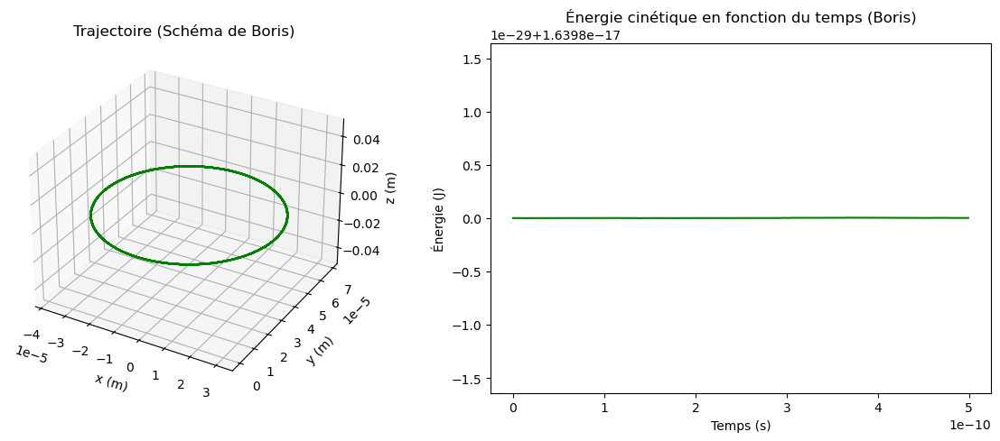

In [64]:
# Méthode de Boris
def boris(particle, E, B_func, dt, steps):
    """
    Met à jour la vitesse et la position d'une particule au sein d'un champ magnétique selon la méthode de Boris.
    
    Paramètres :
    - particule : instance de la classe Particule
    - E : np.array shape (3,) -> champ électrique au point de la particule
    - B : np.array shape (3,) -> champ magnétique au point de la particule
    - dt : float -> pas de temps
    """
    # Initialisation des listes pour stocker les positions et énergies
    positions = []
    energies = []

    for _ in range(steps):
        # Convertion du champ magnétique et du champ électrique en tableaux numpy
        B = np.array(B_func(particle.position), dtype=float)  # Champ magnétique converti en tableau numpy
        E = np.array(E, dtype=float)              # Champ électrique conerti en tableau numpy

        # Paramètres de la particule
        q = particle.charge                       # Charge de la particule
        m = particle.masse                        # Masse de la particule
        v = particle.vitesse.copy()               # Vitesse de la particule

        # Etape 1 : demi-accélération par E
        v_minus = v + (q * E * dt) / (2 * m)      # Vitesse après demi-accélération
        
        # Etape 2 : rotation autour de B
        t = (q * B * dt) / (2 * m)                # Vecteur t pour la rotation
        s = (2 * t) / (1 + np.dot(t, t))          # Vecteur s pour la rotation
        v_prime = v_minus + np.cross(v_minus, t)  # Vitesse après rotation
        v_plus = v_minus + np.cross(v_prime, s)   # Vitesse après seconde rotation

        # Etape 3 : autre demi-accélération par E
        v_new = v_plus + (q * E / (2 * m)) * dt   # Vitesse après seconde demi-accélération

        # Mise à jour de la vitesse et de la position
        particle.vitesse = v_new                  # Mise à jour de la vitesse
        particle.position += v_new * dt           # Mise à jour de la position

        # Stocker position et énergie
        positions.append(particle.position.copy())
        energie = 0.5 * m * np.dot(particle.vitesse, particle.vitesse)
        energies.append(energie)

    return np.array(positions), np.array(energies)


# ==================== Simulation avec la méthode de Boris ==================== #

# Paramètres de la simulation
dt = 1e-12
steps = 500

# Réinitialiser la position de l'électron
electron.position = np.array([0, 0, 0], dtype=float)
electron.vitesse = np.array([6e6, 0, 0], dtype=float)

# Lancer la simulation avec Boris (avec champ électrique nul)
positions_boris, energies_boris = boris(electron, 0, champ_uniforme, dt, steps)

# Affichage 3D et énergie
fig = plt.figure(figsize=(12, 5))

# Trajectoire 3D
ax1 = fig.add_subplot(121, projection='3d')
ax1.plot(positions_boris[:, 0], positions_boris[:, 1], positions_boris[:, 2], color='green')
ax1.set_title("Trajectoire (Schéma de Boris)")
ax1.set_xlabel("x (m)")
ax1.set_ylabel("y (m)")
ax1.set_zlabel("z (m)")

# Énergie cinétique
ax2 = fig.add_subplot(122)
ax2.plot(np.arange(steps) * dt, energies_boris, color='green')
ax2.set_title("Énergie cinétique en fonction du temps (Boris)")
ax2.set_xlabel("Temps (s)")
ax2.set_ylabel("Énergie (J)")

plt.tight_layout()
plt.show()


On constate ainsi que la méthode de Boris permet davantage de souplesse quant à l'augmentation du pas de temps $\mathrm{d}t$ et au nombre d'itérations nécessaires pour couvrir 'l'entièreté' de la trajetoire. C'est une méthode stable, conservatrice d'énergie dans un champ magnétique pur, et spécifiquement adaptée aux cas des particules chargées dans un champ magnétique. <br>

<br>
<br>

#### **III.2. Cas 2 : Simulation de la trajectoire d'un électron au sein d'un champ non-uniforme avec Euler vs Boris**

Nous allons maintenant comparé les deux méthodes dans le cas où le champ magnétique n'est plus uniforme. <br>
Prenons par exemple le champ :
$$
\vec{B}(x,y,z) = \begin{bmatrix} 
0.5 \ y \\ 
-0.5 \ x \\ 
1 + 0.1 \ z
\end{bmatrix}
$$

On suppose qu'il n'y a pas de champ électrique ($E=0$), et on applique les méthodes pour une même particule, même conditions initiales, afin de tracer la trajectoire de celle-ci :

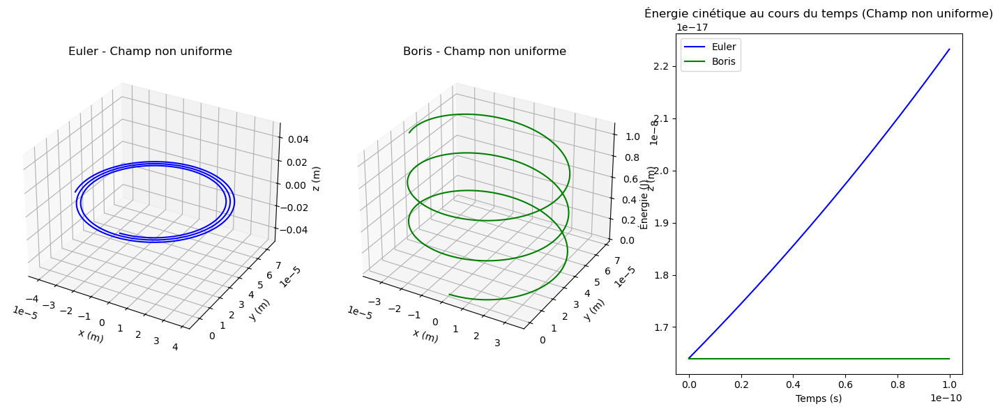

In [65]:
def champ_non_uniforme(pos):
    x, y, z = pos
    return np.array([
        0.5 * y,          # Bx dépend de y
        -0.5 * x,         # By dépend de x
        1 + 0.1 * z       # Bz légèrement non-uniforme
    ])

# Initialisation des paramètres de la simulation
dt = 1e-13
steps = 1000

# Réinitialisation de la position de la particule pour euler
electron.position = np.array([0, 0, 0], dtype=float)
electron.vitesse = np.array([6e6, 0, 0], dtype=float)

# Simulation Euler avec champ non uniforme
pos_euler_non_unif, en_euler_non_unif = simuler_trajectoire_euler(champ_non_uniforme(electron.position), dt, steps)

# Réinitialisation de la position de la particule pour Boris
electron.position = np.array([0, 0, 0], dtype=float)
electron.vitesse = np.array([6e6, 0, 0], dtype=float)

# Simulation Boris avec champ non uniforme
pos_boris_non_unif, en_boris_non_unif = boris(electron, 0, champ_non_uniforme, dt, steps)

# ========== Affichage comparatif ========== #

fig = plt.figure(figsize=(14, 6))

# Trajectoire 3D Euler
ax1 = fig.add_subplot(131, projection='3d')
ax1.plot(pos_euler_non_unif[:, 0], pos_euler_non_unif[:, 1], pos_euler_non_unif[:, 2], label="Euler", color="blue")
ax1.set_title("Euler - Champ non uniforme")
ax1.set_xlabel("x (m)")
ax1.set_ylabel("y (m)")
ax1.set_zlabel("z (m)")

# Trajectoire 3D Boris
ax2 = fig.add_subplot(132, projection='3d')
ax2.plot(pos_boris_non_unif[:, 0], pos_boris_non_unif[:, 1], pos_boris_non_unif[:, 2], label="Boris", color="green")
ax2.set_title("Boris - Champ non uniforme")
ax2.set_xlabel("x (m)")
ax2.set_ylabel("y (m)")
ax2.set_zlabel("z (m)")

# Énergie cinétique
ax3 = fig.add_subplot(133)
ax3.plot(np.arange(steps) * dt, en_euler_non_unif, label="Euler", color="blue")
ax3.plot(np.arange(steps) * dt, en_boris_non_unif, label="Boris", color="green")
ax3.set_title("Énergie cinétique au cours du temps (Champ non uniforme)")
ax3.set_xlabel("Temps (s)")
ax3.set_ylabel("Énergie (J)")
ax3.legend()

plt.tight_layout()
plt.show()

On observe bien les limites de la méthode d'Euler qui peine à obtenir la bonne trajectoire et conserver l'énergie cinétique de la particule, contrairement à la méthode de Boris qui est plus adaptée.

---

### **IV. Application à la protonthérapie**

#### **IV.1. Qu'est-ce que la protonthérapie ?**
La protonthérapie est une méthode de radiothérapie avancée qui utilise des protons pour traiter les tumeurs. Contrairement à la radiothérapie classique qui utilise des rayons X, la protonthérapie exploite les propriétés physiques des protons, des particules subatomiques chargées, qui peuvent être dirigées avec une grande précision vers la cible tumorale. L'un des principaux avantages de cette technique est sa capacité à délivrer une dose de radiation élevée directement à la tumeur tout en minimisant les effets secondaires sur les tissus sains environnants.

Les champs magnétiques jouent un rôle crucial dans ce processus, car ils permettent de contrôler la trajectoire des protons au sein des accélérateurs. En effet, ces particules chargées, lorsqu'elles sont accélérées à des vitesses proches de celle de la lumière, sont sensibles aux champs magnétiques. Ces derniers sont générés par des bobines conductrices traversées par un courant électrique, conformément à la loi de Biot et Savart, qui décrit la relation entre le courant dans un conducteur et le champ magnétique produit. Grâce à l'application de ces champs magnétiques, on peut diriger les protons avec une précision extrême, de manière à concentrer l'énergie sur la tumeur et ainsi optimiser le traitement.

Dans le cadre de la protonthérapie, des dispositifs tels que des aimants supraconducteurs sont utilisés pour créer des champs magnétiques puissants et stables. Ces aimants permettent de guider les protons avec une grande précision, en ajustant leur trajectoire afin qu'ils atteignent la cible avec la meilleure efficacité possible. La capacité de contrôler finement le champ magnétique est essentielle pour éviter toute irradiation des tissus sains, un aspect fondamental pour garantir la sécurité et l'efficacité du traitement.

<br>

#### **IV.2. Implémentation de la loi de Biot et Savart**

Lorsqu'un fil conducteur est traversé par un courant électrique $I$, il génère un champ magnétique $\overrightarrow{\mathrm{B}}$ conformément à la loi de Biot-Savart qui s'exprime :
$$
\overrightarrow{\mathrm{dB}} = \frac{\mu_0 I}{4\pi} \frac{\overrightarrow{\mathrm{d\ell}} \times \overrightarrow{PM}}{PM^3}
$$
Où :
- $\overrightarrow{\mathrm{dB}}$ est le champ magnétique élémentaire en un point $\vec{r}$
- $\mu_0$ est la perméabilité du vide,
- $I$ est le courant,
- $\overrightarrow{\mathrm{d\ell}}$ est un élément infinitésimal de la trajectoire du courant,
- $\overrightarrow{PM}$ est le vecteur reliant le point source de l'élément de courant $M$ au point d'observation $P$, 
- $|\overrightarrow{PM}|$ est la distance entre les deux points.

Ainsi le champ magnétique total créé par un segment élémentaire de courant s'exprime :
$$
\overrightarrow{B}(M) = \int_{P \in \mathcal{C}} \overrightarrow{\mathrm{d}B}
= \frac{\mu_0}{4\pi} \int_{P \in \mathcal{C}} \frac{I \overrightarrow{\mathrm{d}\ell} \times \overrightarrow{PM}}{\|PM\|^3}
$$

La bobine conductrice peut être modélisée comme une série de segments de courant. Lorsqu'un courant traverse une bobine de forme circulaire ou hélicoïdale, le champ magnétique généré peut être approximé par la somme des champs produits par chacun des segments de courant. <br>
Une bobine circulaire avec un rayon $R$, traversée par un courant $I$, génère un champ magnétique sur son axe (l'axe z) qui est donné par l'expression suivante (voir [Annexe](#Annexe)) :
$$
B = \frac{\mu_0 I R²}{2(z^2 + R^2)^{3/2}}
$$
Où :
- $\mu_0 = 4\pi \times 10^{−7}$ est la perméabilité du vide,
- $I$ est le courant dans le fil (en A),
- $R$ est le rayon de la bobine (en m),
- $z$ est la distance axiale (en m) du centre de la bobine.

Mettons maintenant cela en pratique dans notre code :

In [66]:
def champ_bobine_biot_savart(position, I=100, R=0.01, N=100):
    """
    Calcule le champ magnétique au point `position` (np.array([x, y, z])) 
    généré par une bobine circulaire de rayon R et de courant I, 
    discrétisée en N segments.

    Retourne un vecteur champ magnétique np.array([Bx, By, Bz]).
    """
    B = np.zeros(3)
    mu_0 = 4 * np.pi * 1e-7   # Perméabilité du vide (T.m/A)
    dtheta = 2 * np.pi / N    # Angle entre chaque segment de la bobine

    # Pour chaque segment de courant dans la bobine
    for i in range(N):
        theta = i * dtheta    # Angle du segment courant
        theta_next = (i + 1) * dtheta  # Angle du segment suivant

        # Positions des extrémités d'un segment de la bobine
        P1 = np.array([R * np.cos(theta), R * np.sin(theta), 0.01])
        P2 = np.array([R * np.cos(theta_next), R * np.sin(theta_next), 0.01])

        dl = P2 - P1       # Vecteur courant élémentaire
        PM = position - P1 # Vecteur allant de la source vers le point d'observation

        PM_norm = np.linalg.norm(PM) + 1e-10  # évite division par zéro
        dB = (mu_0 * I) / (4 * np.pi) * np.cross(dl, PM) / (PM_norm**3)  # Champ magnétique élémentaire

        B += dB  # Somme des contributions de chaque segment

    return B


<br>

#### **IV.3. Simulation de la trajectoire (avec la méthode de Boris) et ajustement**


In [67]:
from ipywidgets import interactive, FloatSlider
import matplotlib.image as mpimg

# Fonction pour lancer la simulation et afficher
def simuler(I, R):

    # ========== Simuler la trajectoire du proton ========== #

    proton = Particule(
        position=[-0.2, -0.2, 0],    # m
        vitesse=[0, 2.4e7, 0], # m/s
        charge=1.6e-19,  # Charge du proton (C)
        masse=1.67e-27   # Masse du proton (kg)
    )
    E = np.array([0, 0, 0])
    dt = 1e-12
    steps = 5000

    traj, _ = boris(proton, E, lambda pos: champ_bobine_biot_savart(pos, I, R), dt, steps)

    # ========== Importer et positionner l'image ========== #

    # Charger l'image
    img = mpimg.imread('protonthérapie.jpg') / 255  # normaliser entre 0 et 1
    img = np.flipud(img)  # Retourner l'image pour l'afficher correctement

    # Création de la figure et des axes pour la simulation
    fig = plt.figure(figsize=(11,6))
    ax = fig.add_subplot(111, projection='3d')

    # # --- Bobine (cylindre gris translucide) ---
    # theta = np.linspace(0, 2*np.pi, 30)
    # z_cyl = np.linspace(-0.02, 0.02, 30)
    # theta, z_cyl = np.meshgrid(theta, z_cyl)
    # r = 0.005  # Rayon de la bobine (5 mm)

    # x_cyl = r * np.cos(theta)
    # y_cyl = r * np.sin(theta)
    # z_cyl = z_cyl 
    # ax.plot_surface(x_cyl, y_cyl, z_cyl, color='gray', alpha=0.3, linewidth=0)

    # Fixer les limites pour correspondre à la trajectoire observée
    ax.set_xlim(traj[:,0].min(), traj[:,0].max()) # x : m
    ax.set_ylim(traj[:,1].min(), traj[:,1].max()) # y : m
    ax.set_zlim(traj[:,2].min(), traj[:,2].max()) # z : m

    # Récupération des bornes du plan (x,z)
    x_min, x_max = traj[:,0].min(), traj[:,0].max()
    z_min, z_max = traj[:,2].min(), traj[:,2].max()

    # Création de la grille adaptée à la taille de l’image
    x = np.linspace(x_min, x_max, img.shape[1])
    z = np.linspace(z_min, z_max, img.shape[0])
    X, Z = np.meshgrid(x, z)

    # Plan fixe en y
    y_fixed = traj[-1, 1] + R/20
    Y = np.full_like(X, y_fixed)

    # ========== Affichage de l'image et de la tracetoire du proton ========== #

    # Affichage de l’image projetée comme surface sur le plan (x,z)
    ax.plot_surface(X, Y, Z, rstride=1, cstride=1, facecolors=img, shade=False)

    # Tracé de la trajectoire du proton
    ax.plot(traj[:,0], traj[:,1], traj[:,2], label='Trajectoire', color='deepskyblue', zorder=10)
    ax.set_xlabel('x (m)')
    ax.set_ylabel('y (m)')
    ax.set_zlabel('z (m)')
    ax.set_title('Trajectoire des protons')
    ax.legend()
    plt.show()

# Widgets interactifs
interactive_plot = interactive(
    simuler,
    I=FloatSlider(min=1e6, max=1e7, step=1e5, value=7500000, description='I (A)'),
    R=FloatSlider(min=0.1, max=4, step=0.1, value=0.65, description='R (m)')
)

display(interactive_plot)


interactive(children=(FloatSlider(value=7500000.0, description='I (A)', max=10000000.0, min=1000000.0, step=10…

In [69]:
from ipywidgets import interactive, FloatSlider
import matplotlib.image as mpimg

# Fonction pour lancer la simulation et afficher
def simuler(I, R):

    # ========== Simuler la trajectoire du proton ========== #

    proton = Particule(
        position=[-0.2, -0.2, 0],    # m
        vitesse=[0, 2.4e7, 0], # m/s
        charge=1.6e-19,  # Charge du proton (C)
        masse=1.67e-27   # Masse du proton (kg)
    )
    E = np.array([0, 0, 0])
    dt = 1e-12
    steps = 5000

    traj, _ = boris(proton, E, lambda pos: champ_bobine_biot_savart(pos, I, R), dt, steps)

    # ========== Importer et positionner l'image ========== #

    # Charger l'image
    img = mpimg.imread('protonthérapie.jpg') / 255  # normaliser entre 0 et 1
    img = np.flipud(img)  # Retourner l'image pour l'afficher correctement

    # Création de la figure et des axes pour la simulation
    fig = plt.figure(figsize=(11,6))
    ax = fig.add_subplot(111, projection='3d')

    # # --- Bobine (cylindre gris translucide) ---
    # theta = np.linspace(0, 2*np.pi, 30)
    # z_cyl = np.linspace(-0.02, 0.02, 30)
    # theta, z_cyl = np.meshgrid(theta, z_cyl)
    # r = 0.005  # Rayon de la bobine (5 mm)

    # x_cyl = r * np.cos(theta)
    # y_cyl = r * np.sin(theta)
    # z_cyl = z_cyl 
    # ax.plot_surface(x_cyl, y_cyl, z_cyl, color='gray', alpha=0.3, linewidth=0)

    # Fixer les limites pour correspondre à la trajectoire observée
    ax.set_xlim(traj[:,0].min(), traj[:,0].max()) # x : m
    ax.set_ylim(traj[:,1].min(), traj[:,1].max()) # y : m
    ax.set_zlim(traj[:,2].min(), traj[:,2].max()) # z : m

    # Récupération des bornes du plan (x,z)
    x_min, x_max = traj[:,0].min(), traj[:,0].max()
    z_min, z_max = traj[:,2].min(), traj[:,2].max()

    # Création de la grille adaptée à la taille de l’image
    x = np.linspace(x_min, x_max, img.shape[1])
    z = np.linspace(z_min, z_max, img.shape[0])
    X, Z = np.meshgrid(x, z)

    # Plan fixe en y
    y_fixed = traj[-1, 1] + 0.057
    Y = np.full_like(X, y_fixed)

    # ========== Affichage de l'image et de la tracetoire du proton ========== #

    # Affichage de l’image projetée comme surface sur le plan (x,z)
    ax.plot_surface(X, Y, Z, rstride=1, cstride=1, facecolors=img, shade=False)

    # Tracé de la trajectoire du proton
    ax.plot(traj[:,0], traj[:,1], traj[:,2], label='Trajectoire', color='deepskyblue', zorder=10)
    ax.set_xlabel('x (m)')
    ax.set_ylabel('y (m)')
    ax.set_zlabel('z (m)')
    ax.set_title('Trajectoire des protons')
    ax.legend()
    plt.show()

# Widgets interactifs
interactive_plot = interactive(
    simuler,
    I=FloatSlider(min=1e6, max=1e7, step=1e5, value=7500000, description='I (A)'),
    R=FloatSlider(min=0.1, max=4, step=0.1, value=0.2, description='R (m)')
)

display(interactive_plot)

interactive(children=(FloatSlider(value=7500000.0, description='I (A)', max=10000000.0, min=1000000.0, step=10…

---

### **Conclusion**

---

### **Annexes/Sources <a name="Annexe"></a>**

Méthode de Boris : <br>
- https://www.particleincell.com/2011/vxb-rotation/

Champ magnétique dû à une bobine circulaire: <br>
- https://physics.nyu.edu/~physlab/GenPhysI_PhysII/Intro_experimental_physicsII_write_ups/Magnetic-field-circular-coil_01_30_2017.pdf *Partie 4. équation (1)* <br>

- https://www.doubtnut.com/qna/642522489 <br>

Vitesse d'un proton dans un accélérateur :
- https://www.psi.ch/fr/research/laccelerateur-de-protons-du-psi